In [1]:
import holoviews as hv
import geoviews as gv
import geoviews.feature as gf
import xarray as xr
import iris
import numpy as np
from cartopy import crs

hv.notebook_extension()

In [2]:
xr_ensemble = xr.open_dataset('C:/Users/Mario Castro/DATA/Personal/Hackathon_DATAVizRM/PenDrive/code/CERSAT-GLO-BLENDED_WIND_L4-V5-OBS_FULL_TIME_SERIE_1497101246720.nc')
xr_ensemble

<xarray.Dataset>
Dimensions:         (depth: 1, latitude: 641, longitude: 1440, time: 29)
Coordinates:
  * time            (time) datetime64[ns] 2017-06-01T06:00:00 ...
  * longitude       (longitude) float32 -180.0 -179.75 -179.5 -179.25 -179.0 ...
  * latitude        (latitude) float32 -80.0 -79.75 -79.5 -79.25 -79.0 ...
  * depth           (depth) float32 10.0
Data variables:
    eastward_wind   (time, depth, latitude, longitude) float64 -3.83 -3.85 ...
    wind_speed      (time, depth, latitude, longitude) float64 6.6 6.59 6.57 ...
    northward_wind  (time, depth, latitude, longitude) float64 5.38 5.34 ...
Attributes:
    title:            Global Ocean - Wind Analysis - Blended ASCAT-SSM/I - 6 ...
    institution:      ifremer
    references:       See User Guide and (Bentamy et al, 2009, 2010)
    source:           produced at 2017-06-10
    Conventions:      CF-1.0
    history:          Data extracted from dataset http://cmems.isac.cnr.it:80...
    time_min:         1029246.0
  

C:\Users\Mario Castro\AppData\Local\Continuum\Anaconda3\lib\site-packages\matplotlib\colors.py:581: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)
C:\Users\Mario Castro\AppData\Local\Continuum\Anaconda3\lib\site-packages\matplotlib\colors.py:581: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)
C:\Users\Mario Castro\AppData\Local\Continuum\Anaconda3\lib\site-packages\matplotlib\colors.py:581: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)
C:\Users\Mario Castro\AppData\Local\Continuum\Anaconda3\lib\site-packages\matplotlib\colors.py:581: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)
C:\Users\Mario Castro\AppData\Local\Continuum\Anaconda3\lib\site-packages\matplotlib\colors.py:581: RuntimeWarning: invalid value encountered in less
  cbook._putmask(xa, xa < 0.0, -1)
C:\Users\Mario Castro\AppData\Local\Continuum\Anaconda3\lib\site-packages\m

:HoloMap   [time]
   :Image   [longitude,latitude]   (wind_speed)
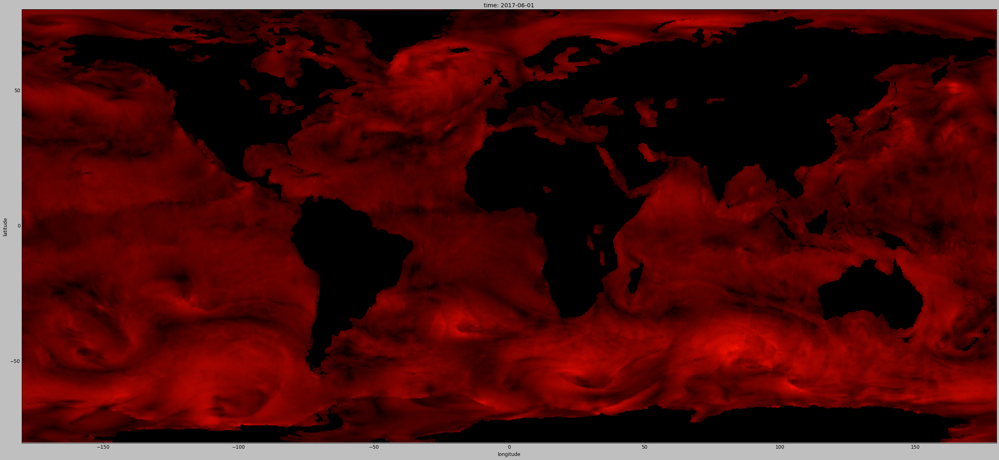
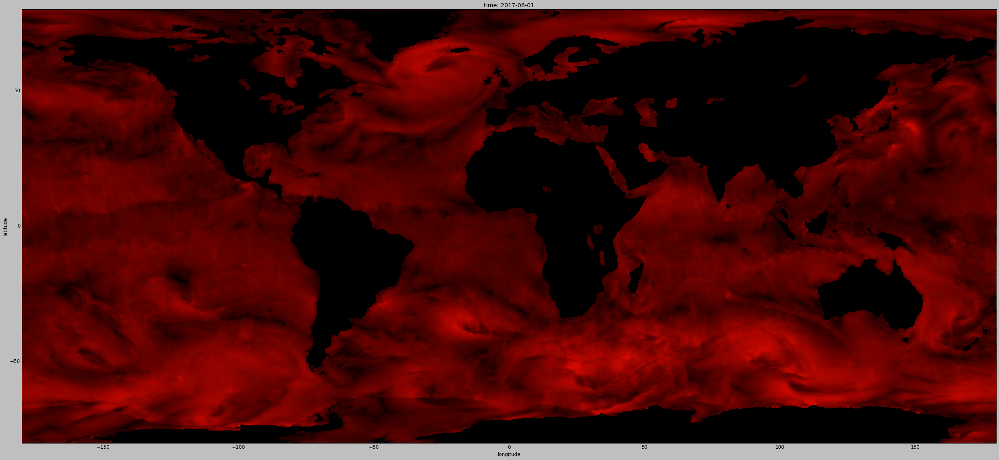
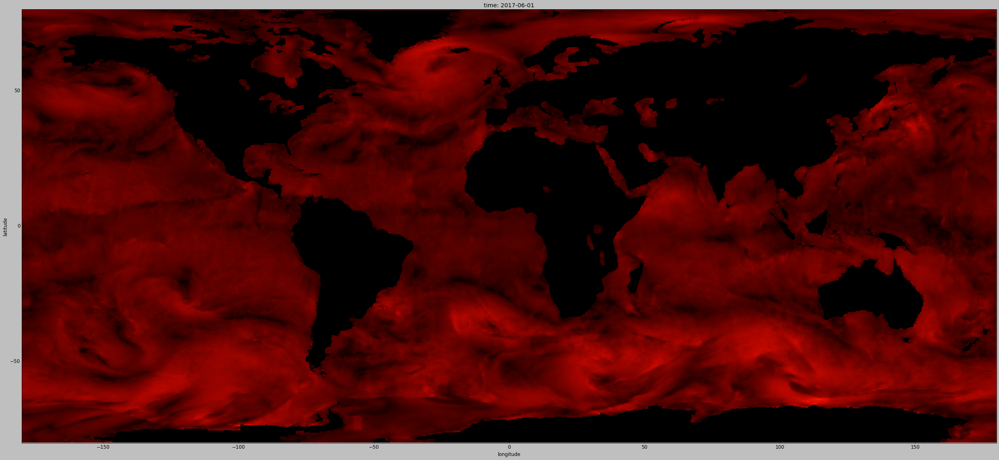
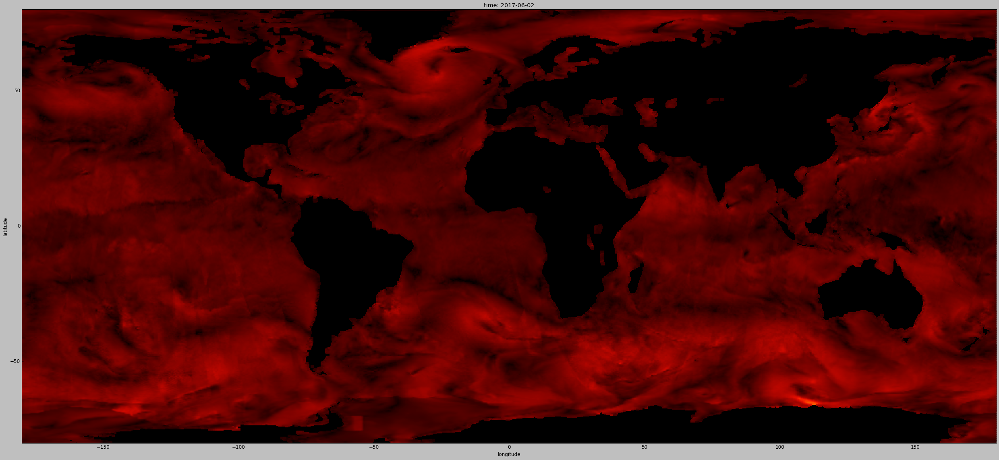
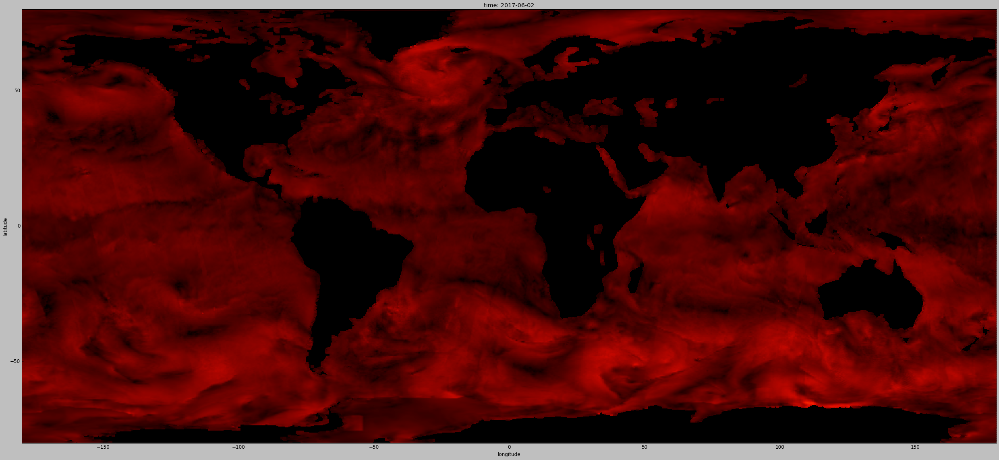
...
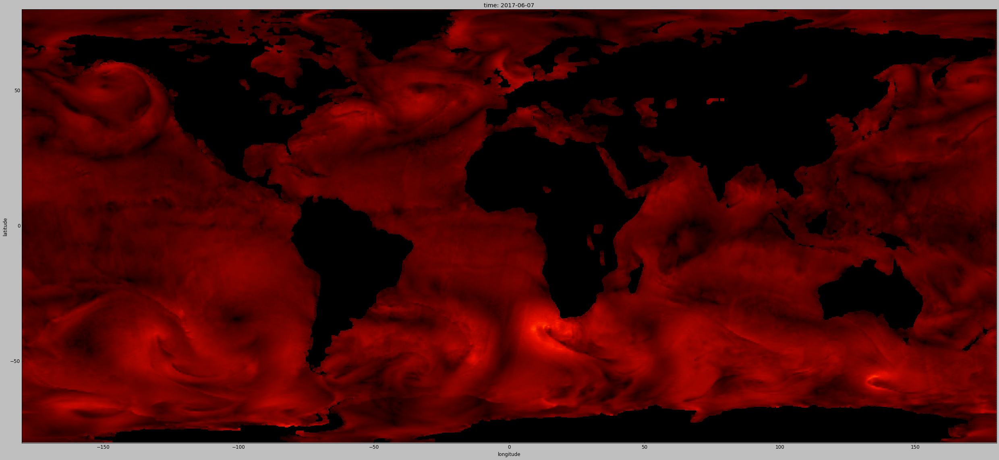
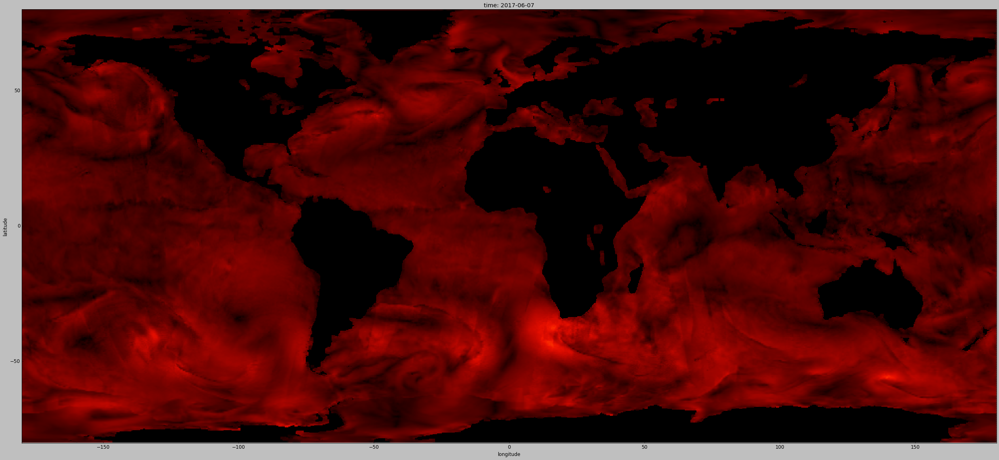
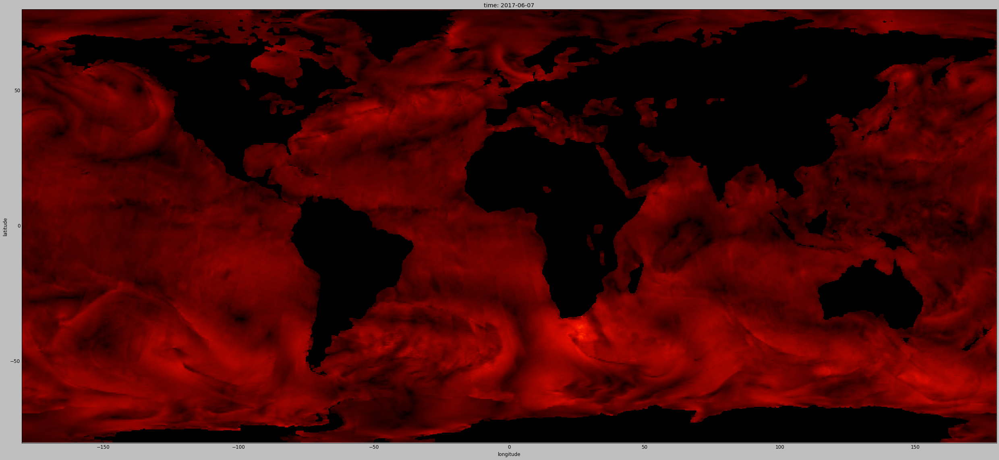
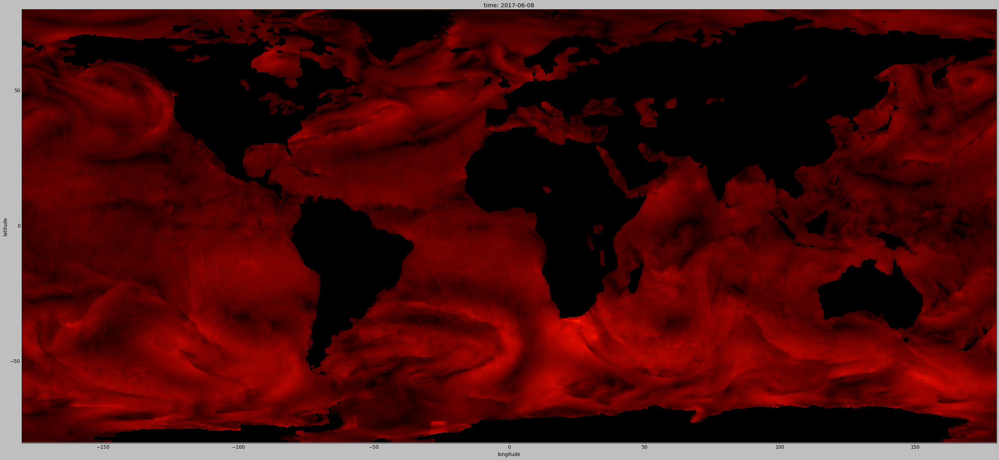
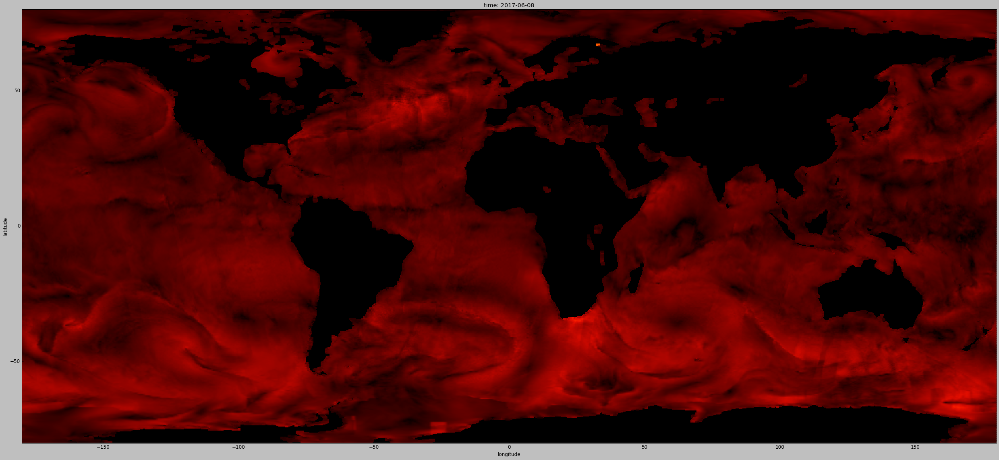

In [7]:
%%output size=1200
kdims = ['time', 'longitude', 'latitude']
vdims = ['wind_speed']

xr_dataset = gv.Dataset(xr_ensemble, kdims=kdims, vdims=vdims, crs=crs.PlateCarree())
hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'
xr_dataset.to(gv.Image, ['longitude', 'latitude'])

In [8]:
vdims

['wind_speed']

In [4]:
iris.FUTURE.netcdf_promote=True
iris_ensemble = iris.load_cubes('C:/Users/Mario Castro/DATA/Personal/Hackathon_DATAVizRM/PenDrive/code/CERSAT-GLO-BLENDED_WIND_L4-V5-OBS_FULL_TIME_SERIE_1497101246720.nc',constraints='wind_speed')
kdims = ['time' ,'longitude', 'latitude']
vdims = ['wind_speed']
print (iris_ensemble)

0: wind_speed / (m/s)                  (time: 29; depth: 1; latitude: 641; longitude: 1440)


In [5]:
iris_dataset = gv.Dataset(iris_ensemble, kdims=kdims, vdims=vdims)


ValueError: None of the available storage backends were able to support the supplied data format.